# Data Pre-Processing

1) import the dataset. use various methods (such as .unique and .value_counts) to learn relevant information about the dataset.

2) convert features with two non-numerical values into 0s and 1s.

3) convert features with more than two non-numerical values into numerical values with a one-hot feature vector.

4) separate into train and test sets. The train and test sets should have equal ratios of "Has heart disease" to "does not have heart disease", so you will either have to manually do this or find a library that can ensure even distribution in the train/test split. sklearn's train_test_split may have a way to make this happen, or it may not.

By the end of this section, these variables should exist. The training and test sets must have equal ratios of the two classes (has heart disease & doesn't have heart disease):

X: pandas dataset, minus the feature indicating whether the person has heart disease

y: pandas dataset, but only with the feature indicating whether the person has heart disease

X_train: numpy array. Subset of X including 70% of samples

y_train: numpy array. Samples from y matching with the samples in X_train

X_test: numpy array. the other 30% of the samples.

y_test: numpy array. Samples from y matching with the samples in X_test.

In [1]:
import pandas as pd

dataset_url = "https://raw.githubusercontent.com/MichaelMcGilvray/Health-And-Med-Group2/main/heart_2020_cleaned.csv"
df = pd.read_csv(dataset_url)

import warnings
warnings.filterwarnings('ignore')

In [2]:
import numpy as np

# Convert yes/no to 1/0
corrected_yes_no_data = { "HeartDisease" : {"No": 0, "Yes": 1},
                  "Smoking" : {"No": 0, "Yes": 1},
                  "AlcoholDrinking" : {"No": 0, "Yes": 1},
                  "Stroke" : {"No": 0, "Yes": 1},
                  "DiffWalking" : {"No": 0, "Yes": 1},
                  "PhysicalActivity" : {"No": 0, "Yes": 1},
                  "Asthma" : {"No": 0, "Yes": 1},
                  "KidneyDisease" : {"No": 0, "Yes": 1},
                  "SkinCancer" : {"No": 0, "Yes": 1} }

df = df.replace(corrected_yes_no_data)
heatmap_df= df


# Convert continuous data to a usable form
corrected_AgeCategory = { "18-24" : 0, "25-29" : 1, "30-34" : 2, "35-39" : 3, "40-44" : 4,
                          "45-49" : 5, "50-54" : 6, "55-59" : 7, "60-64" : 8, "65-69" : 8,
                          "70-74" : 10, "75-79" : 11, "80 or older" : 12 }
df = df.replace(corrected_AgeCategory)

corrected_Diabetic = { "No" : 0, "No, borderline diabetes" : 1, "Yes (during pregnancy)" : 2, "Yes" : 2 }
df = df.replace(corrected_Diabetic)

corrected_GenHealth = { "Poor" : 0, "Fair" : 1, "Good" : 2, "Very good" : 3, "Excellent" : 4 }
df = df.replace(corrected_GenHealth)


# Convert categorical data to 1/0 using one-hot encoding
# df = pd.get_dummies(df, columns=["GenHealth", "PhysicalHealth", "MentalHealth", "Sex", "AgeCategory", "Race", "Diabetic", "SleepTime"])
df = pd.get_dummies(df, columns=["Sex", "Race"])


# Formula Source: https://www.stackvidhya.com/how-to-normalize-data-between-0-and-1-range/
def normalize_zero_one(i):
  return (i - np.min(i)) / (np.max(i) - np.min(i))

# Convert continuous data to normalized scalar between 0 and 1
df["BMI"] = normalize_zero_one(df["BMI"])
df["AgeCategory"] = normalize_zero_one(df["AgeCategory"])
df["MentalHealth"] = normalize_zero_one(df["MentalHealth"])
df["PhysicalHealth"] = normalize_zero_one(df["PhysicalHealth"])
df["Diabetic"] = normalize_zero_one(df["Diabetic"])
df["GenHealth"] = normalize_zero_one(df["GenHealth"])
df["SleepTime"] = normalize_zero_one(df["SleepTime"])

In [3]:
df

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,AgeCategory,Diabetic,...,KidneyDisease,SkinCancer,Sex_Female,Sex_Male,Race_American Indian/Alaskan Native,Race_Asian,Race_Black,Race_Hispanic,Race_Other,Race_White
0,0,0.055294,1,0,0,0.100000,1.0,0,0.583333,1.0,...,0,1,1,0,0,0,0,0,0,1
1,0,0.100447,0,0,1,0.000000,0.0,0,1.000000,0.0,...,0,0,1,0,0,0,0,0,0,1
2,0,0.175782,1,0,0,0.666667,1.0,0,0.666667,1.0,...,0,0,0,1,0,0,0,0,0,1
3,0,0.147169,0,0,0,0.000000,0.0,0,0.916667,0.0,...,0,1,1,0,0,0,0,0,0,1
4,0,0.141132,0,0,0,0.933333,0.0,1,0.333333,0.0,...,0,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319790,1,0.185802,1,0,0,0.233333,0.0,1,0.666667,1.0,...,0,0,0,1,0,0,0,1,0,0
319791,0,0.215139,1,0,0,0.000000,0.0,0,0.250000,0.0,...,0,0,0,1,0,0,0,1,0,0
319792,0,0.147531,0,0,0,0.000000,0.0,0,0.416667,0.0,...,0,0,1,0,0,0,0,1,0,0
319793,0,0.250996,0,0,0,0.000000,0.0,0,0.083333,0.0,...,0,0,1,0,0,0,0,1,0,0


In [4]:
# Split dataframe into X and y

# X: pandas dataset, minus the feature indicating whether the person has heart disease
X = df.drop(labels="HeartDisease", axis=1)

# y: pandas dataset, but only with the feature indicating whether the person has heart disease
y = pd.DataFrame(df["HeartDisease"])

In [5]:
from sklearn.model_selection import train_test_split

# X_train: numpy array. Subset of X including 80% of samples
# y_train: numpy array. Samples from y matching with the samples in X_train
# X_test: numpy array. the other 20% of the samples.
# y_test: numpy array. Samples from y matching with the samples in X_test.
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size= 0.8, test_size=0.2, stratify=y["HeartDisease"])

In [6]:
# Verify the ratio of has heart disease to doesn't have heart disease was maintained during split
print("Original dataset:")
print("Doesn't have heart disease: %f %%" %((df["HeartDisease"].value_counts()[0] / df.shape[0])*100))
print("Has heart disease: %f %%\n" %((df["HeartDisease"].value_counts()[1] / df.shape[0])*100))

print("After split -\ntrain set -")
print("Doesn't have heart disease: %f %%" %((y_train["HeartDisease"].value_counts()[0] / y_train.shape[0])*100))
print("Has heart disease: %f %%" %((y_train["HeartDisease"].value_counts()[1] / y_train.shape[0])*100))

print("\ntest -")
print("Doesn't have heart disease: %f %%" %((y_test["HeartDisease"].value_counts()[0] / y_test.shape[0])*100))
print("Has heart disease: %f %%" %((y_test["HeartDisease"].value_counts()[1] / y_test.shape[0])*100))

Original dataset:
Doesn't have heart disease: 91.440454 %
Has heart disease: 8.559546 %

After split -
train set -
Doesn't have heart disease: 91.440610 %
Has heart disease: 8.559390 %

test -
Doesn't have heart disease: 91.439829 %
Has heart disease: 8.560171 %


In [7]:
# If the train and test sets need to be numpy arrays:
# X_train = X_train.to_numpy()
# X_test = X_test.to_numpy()
# y_train = y_train.to_numpy()
# y_test = y_test.to_numpy()

# Correlation Analysis

1) calculate Pearson correlation coefficients for X (not X_train or X_test) & display heat map

2) calculate Spearman correlation coefficients & display heat map

3) If a pair of variables has a very high positive or negative correlation, figure out which one is dependent (may require some research -- remember to save your sources so we can cite them) and drop the dependent variable from both the train and test sets.

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Pearson Correlation Coefficient

In [9]:
X_Coff = heatmap_df.corr()

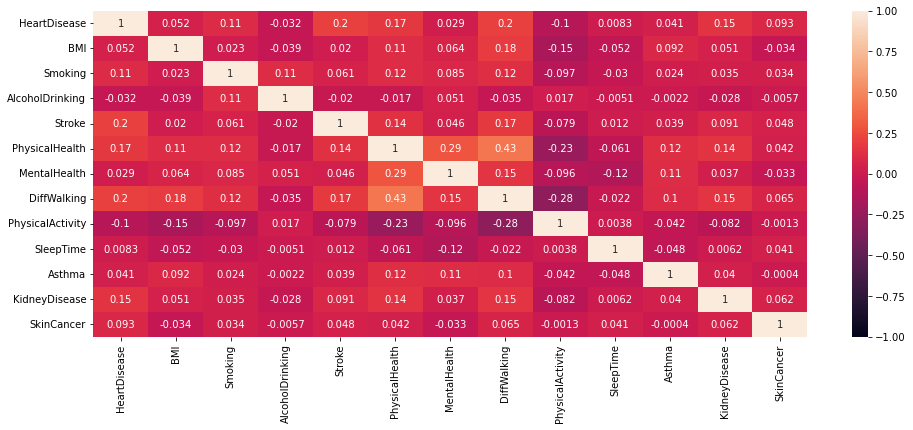

In [10]:
plt.figure(figsize=(16, 6))

heatmap = sns.heatmap(X_Coff, vmin = -1, vmax = 1, annot=True)

Spearman's Correlation Coefficient

In [11]:
X_Coff_spearman = heatmap_df.corr(method = "spearman")

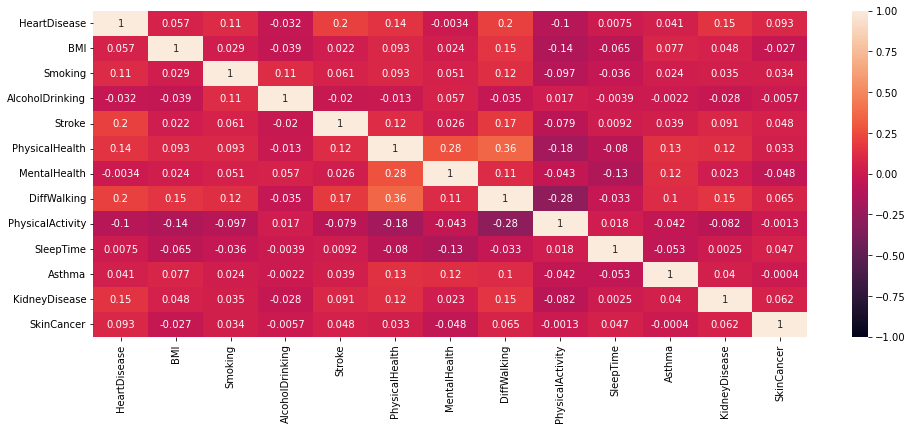

In [12]:
plt.figure(figsize=(16, 6))

heatmap = sns.heatmap(X_Coff_spearman, vmin = -1, vmax = 1, annot=True)

# Classification

Run the following classification models on the data. Account for the severe data imbalance in whatever way is most effective. Show Recall, Accuracy, Precision, F1, AUC, ROC Curve, and Confusion Matrix for each one, ideallyl in a way that allows you to compare multiple classifiers at once. At the end, report the most accurate classifier, which will be used for Shapley value calculation.

In [13]:
import time

from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, recall_score, precision_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report

oversampler = RandomOverSampler()
undersampler = RandomUnderSampler()
samplers = {"raw data": None, 
            "oversampled": oversampler, 
            "undersampled": undersampler}

def print_scores(y_test, y_pred):
  print("Accuracy:", accuracy_score(y_test, y_pred))
  print("F1 score:", f1_score(y_test, y_pred))
  print("AUC ROC score:", roc_auc_score(y_test, y_pred))
  print("Recall:", recall_score(y_test, y_pred))
  print("Precision:", precision_score(y_test, y_pred))

def resample_fit_score(model, resampler, X_train, y_train, X_test, y_test):
    start = time.time()
    if resampler:
        resampled_train_data, resampled_train_label = resampler.fit_resample(X_train, y_train)
    else:
        resampled_train_data, resampled_train_label = X_train, y_train
    model = model.fit(resampled_train_data, resampled_train_label)
    end = time.time()
    print(f"Training time: {end-start}")
    y_pred = model.predict(X_test)
    print(classification_report(y_test, y_pred))
    print_scores(y_test, y_pred)

def run_all_samplers(model, samplers, X_train, y_train, X_test, y_test):
    for sampler_name in samplers:
      resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
      print(f"===============================")
      print(f"{sampler_name}\n\n")
      print(f"===============================")

## Logistic Regression

In [14]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(solver='saga')

# If time allows you to run this the rest of this by uncommenting
# Grid search over hyperparams
# parameter_grid = {'penalty' : ["l2"],'C': np.arange(0, 3, 1),}
# model = GridSearchCV(model, param_grid = parameter_grid, scoring='roc_auc', n_jobs=10, cv=2, verbose=2.2)

for sampler_name in samplers:
    resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"{sampler_name} report\n\n")

Training time: 11.039240837097168
              precision    recall  f1-score   support

           0       0.92      0.99      0.96     58484
           1       0.53      0.11      0.18      5475

    accuracy                           0.92     63959
   macro avg       0.73      0.55      0.57     63959
weighted avg       0.89      0.92      0.89     63959

Accuracy: 0.9154771025188011
F1 score: 0.1811572250833081
AUC ROC score: 0.5500892676731004
Recall: 0.10922374429223744
Precision: 0.5306122448979592
raw data report


Training time: 18.500685930252075
              precision    recall  f1-score   support

           0       0.97      0.75      0.85     58484
           1       0.23      0.78      0.35      5475

    accuracy                           0.75     63959
   macro avg       0.60      0.76      0.60     63959
weighted avg       0.91      0.75      0.80     63959

Accuracy: 0.7522162635438328
F1 score: 0.3491046492525054
AUC ROC score: 0.7631107551876186
Recall: 0.77625570

## SVC-Linear

In [15]:
from sklearn.svm import LinearSVC

model = LinearSVC(verbose=0)

for sampler_name in samplers:
    resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"{sampler_name}\n\n")

Training time: 10.315556287765503
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     58484
           1       0.64      0.04      0.08      5475

    accuracy                           0.92     63959
   macro avg       0.78      0.52      0.52     63959
weighted avg       0.89      0.92      0.88     63959

Accuracy: 0.9159148829719038
F1 score: 0.07594501718213058
AUC ROC score: 0.5191225293949185
Recall: 0.040365296803652966
Precision: 0.6405797101449275
raw data


Training time: 28.06752896308899
              precision    recall  f1-score   support

           0       0.97      0.75      0.84     58484
           1       0.22      0.78      0.35      5475

    accuracy                           0.75     63959
   macro avg       0.60      0.76      0.60     63959
weighted avg       0.91      0.75      0.80     63959

Accuracy: 0.7488860050970153
F1 score: 0.3470872799707305
AUC ROC score: 0.762862466540433
Recall: 0.779726027397260

## SVM-rbf Kernel

In [16]:
# from sklearn.svm import SVC

# model = SVC(kernel='rbf', random_state=0, gamma=10, C=1)

# for sampler_name in samplers:
  
#     resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
#     print(f"{sampler_name}\n\n")

## XGBoost

In [17]:
import xgboost as xgb
from sklearn.ensemble import BaggingClassifier

for sampler_name in samplers:
    xgb_classifier = xgb.XGBClassifier()
    bagging = BaggingClassifier(base_estimator=xgb_classifier, n_estimators=5, max_samples=50, bootstrap=True)
    
    resample_fit_score(bagging, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"bagging classifier {sampler_name}\n\n")
    
    resample_fit_score(xgb_classifier, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"xgb {sampler_name}\n\n")

[21:29:36] WARNING: D:\bld\xgboost-split_1645118015404\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:29:38] WARNING: D:\bld\xgboost-split_1645118015404\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:29:40] WARNING: D:\bld\xgboost-split_1645118015404\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:29:41] WARNING: D:\bld\xgboost-split_1645118015404\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation me

## Neural Network (MLP)

In [18]:
%%time

from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV

# mlp = MLPClassifier(random_state=1111, max_iter=100, hidden_layer_sizes=(200, 100)).fit(X_train, y_train)
# y_pred = mlp.predict(X_test)
# print(print_scores(y_test, y_pred))

model = MLPClassifier(max_iter=100)


# parameter_space = {
#     'hidden_layer_sizes': [(100,200,50),(100,20)],
#     'activation': ['tanh', 'relu'],
#     'solver': ['sgd', 'adam'],
#     'alpha': [0.0001, 0.05],
#     'learning_rate': ['constant','adaptive'],
# }
# gs = GridSearchCV(mlp, parameter_space, n_jobs=-1, cv=2, verbose=3)
# gs.fit(X_train, y_train)
# print('Best params: {}'.format(gs.best_params_)) 
# print('Best Score: {}'.format(gs.best_score_))



Wall time: 7.01 ms


# kNN

In [19]:
%%time

from sklearn.neighbors import KNeighborsClassifier
 
model = KNeighborsClassifier(n_neighbors=8)
# model.fit(X_train, y_train)
# y_pred = model.predict(X_test)
# print_scores(y_test, y_pred)

resample_fit_score(model, samplers['undersampled'], X_train, y_train, X_test, y_test)
print(f"{sampler_name}\n\n")

Training time: 0.08250904083251953
              precision    recall  f1-score   support

           0       0.96      0.76      0.85     58484
           1       0.21      0.70      0.33      5475

    accuracy                           0.75     63959
   macro avg       0.59      0.73      0.59     63959
weighted avg       0.90      0.75      0.80     63959

Accuracy: 0.7540142904047906
F1 score: 0.32779320657979066
AUC ROC score: 0.7298251404825548
Recall: 0.7006392694063927
Precision: 0.21394311210262132
undersampled


Wall time: 49.1 s


## Decision Tree Classifier with Bagging


In [20]:
%%time

from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import BaggingClassifier

tree = DecisionTreeClassifier(max_depth=3, random_state=1111)
bagging = BaggingClassifier(base_estimator=tree, 
                            n_estimators=5, 
                            max_samples=50, 
                            bootstrap=True)

resample_fit_score(bagging, samplers['undersampled'], X_train, y_train, X_test, y_test)
print("Bagging Classifier\n\n")

print(f"Train score: {bagging.score(X_train, y_train)}")
print(f"Test score: {bagging.score(X_test, y_test)}")

resample_fit_score(tree, samplers['undersampled'], X_train, y_train, X_test, y_test)
print("Decision Tree Classifier with Bagging\n\n")

Training time: 0.12436628341674805
              precision    recall  f1-score   support

           0       0.96      0.69      0.80     58484
           1       0.17      0.71      0.28      5475

    accuracy                           0.69     63959
   macro avg       0.57      0.70      0.54     63959
weighted avg       0.89      0.69      0.76     63959

Accuracy: 0.6876592817273566
F1 score: 0.27930300515891626
AUC ROC score: 0.6964388324293668
Recall: 0.7070319634703196
Precision: 0.17402445603308758
Bagging Classifier


Train score: 0.6891289732484873
Test score: 0.6876592817273566
Training time: 0.11622977256774902
              precision    recall  f1-score   support

           0       0.97      0.64      0.77     58484
           1       0.18      0.82      0.29      5475

    accuracy                           0.66     63959
   macro avg       0.58      0.73      0.53     63959
weighted avg       0.91      0.66      0.73     63959

Accuracy: 0.6555136884566676
F1 score: 0.

## Decision Tree Classifier with Boosting


In [21]:
%%time

from sklearn.ensemble import AdaBoostClassifier

tree = DecisionTreeClassifier(max_depth=2, random_state=1111)

adaboost = AdaBoostClassifier(base_estimator=tree,
                              n_estimators=5, 
                              learning_rate=0.1, 
                              random_state=23)

resample_fit_score(adaboost, samplers['undersampled'], X_train, y_train, X_test, y_test)

# Train Decision Tree Classifer
tree = tree.fit(X_train,y_train)

resample_fit_score(tree, samplers['undersampled'], X_train, y_train, X_test, y_test)

Training time: 0.28541111946105957
              precision    recall  f1-score   support

           0       0.96      0.76      0.85     58484
           1       0.21      0.68      0.32      5475

    accuracy                           0.75     63959
   macro avg       0.58      0.72      0.58     63959
weighted avg       0.90      0.75      0.80     63959

Accuracy: 0.7488391000484685
F1 score: 0.315668399079833
AUC ROC score: 0.7161518007969396
Recall: 0.6767123287671233
Precision: 0.20584476915384187
Training time: 0.10643982887268066
              precision    recall  f1-score   support

           0       0.96      0.72      0.83     58484
           1       0.19      0.70      0.30      5475

    accuracy                           0.72     63959
   macro avg       0.58      0.71      0.56     63959
weighted avg       0.90      0.72      0.78     63959

Accuracy: 0.7210244062602604
F1 score: 0.3003019489431787
AUC ROC score: 0.7112065946928778
Recall: 0.6993607305936073
Precisio

## Random Forest Classifier

In [22]:
#grid search
from sklearn.ensemble import RandomForestClassifier

for sampler in samplers:
    parameters = {  
        'n_estimators': [24,28,32],   
        'max_features': ('sqrt','log2','auto'), 
        'max_depth':    (5,10,15),     
        'criterion'   : ['gini', 'entropy'],
    }
    model = RandomForestClassifier()
    gs = GridSearchCV(estimator = model,     
                              param_grid = parameters, 
                              cv = 2,
                              n_jobs = -1,
                              return_train_score = False,
                              scoring = "accuracy"      
                            )

    resample_fit_score(gs, samplers[sampler], X_train, y_train, X_test, y_test)
    print("Grid Search Random Forest\n\n")

# print('Best params: {}'.format(gs.best_params_)) 
# print('Best Score: {}'.format(gs.best_score_))


Training time: 51.66660022735596
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     58484
           1       0.64      0.04      0.08      5475

    accuracy                           0.92     63959
   macro avg       0.78      0.52      0.52     63959
weighted avg       0.89      0.92      0.88     63959

Accuracy: 0.9158679779233572
F1 score: 0.07558838687510737
AUC ROC score: 0.5190141065003455
Recall: 0.04018264840182648
Precision: 0.6358381502890174
Grid Search Random Forest


Training time: 124.186758518219
              precision    recall  f1-score   support

           0       0.97      0.78      0.86     58484
           1       0.23      0.71      0.35      5475

    accuracy                           0.77     63959
   macro avg       0.60      0.74      0.60     63959
weighted avg       0.90      0.77      0.82     63959

Accuracy: 0.7708062977845183
F1 score: 0.34759001290667146
AUC ROC score: 0.7447186039096201
Recall: 0

# Shapley Value Calculation

Calculate the Shapley values for the most accurate classifier, implementing whatever methods are necessary to ensure that this process finishes in a reasonable amount of time.

In [23]:
# !pip install shap
import shap
from datetime import datetime

In [24]:
xgb_explr = shap.Explainer(xgb_classifier)
xgb_shap_values = xgb_explr(X)

In [25]:
k = 500
rfc_explr = shap.Explainer(gs.predict, shap.sample(X_train, k))
rfc_shap_vals = rfc_explr(shap.sample(X_test, k))

Permutation explainer: 501it [00:49,  8.35it/s]                         


In [26]:
dec_tree_explr = shap.Explainer(bagging.predict, shap.sample(X_train, k))
dec_tree_shap_vals = dec_tree_explr(shap.sample(X_test, k))

Permutation explainer: 501it [00:15, 11.19it/s]                         


# Final Analysis & Data Visualizations

Generate all remaining data visualizations, graphs, etc. with the combined results of the correlation analysis and Shapley values. Generate whatever visualizations may be necessary or helpful for both our presentation and invidual rports. Err on the side of too many. Draw conclusions from the visualizations & write them down here.

In [27]:
# xgb_shap_values
# rfc_shap_vals
# dec_tree_shap_values

shap_vals = [xgb_shap_values, rfc_shap_vals, dec_tree_shap_vals]

In [28]:
for shaps in shap_vals:
  print(type(shaps))

<class 'shap._explanation.Explanation'>
<class 'shap._explanation.Explanation'>
<class 'shap._explanation.Explanation'>


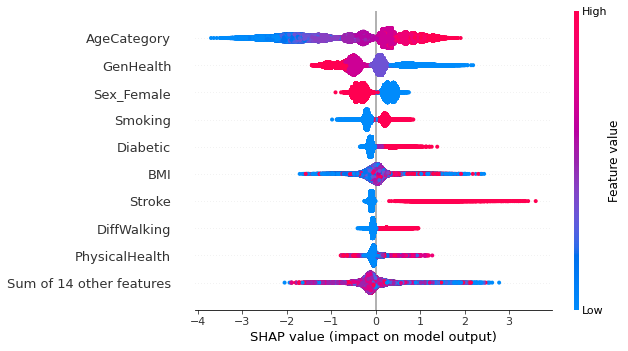

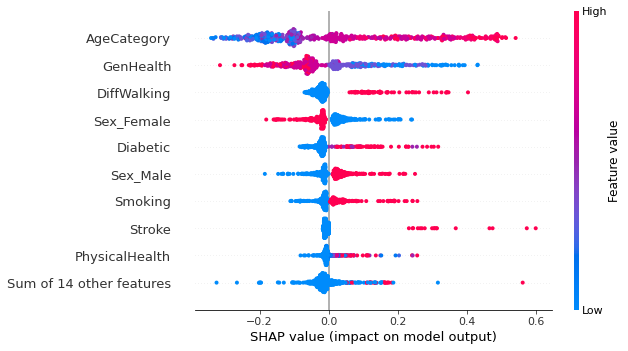

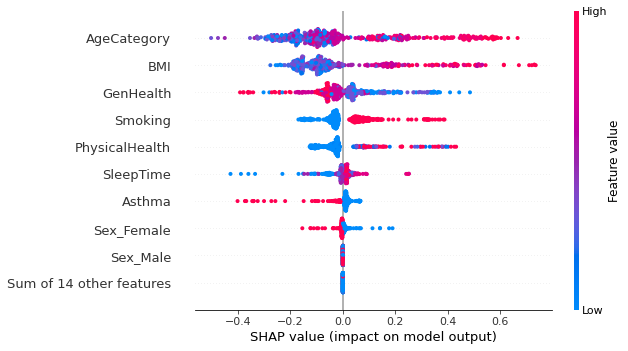

In [29]:
for shaps in shap_vals:
  shap.plots.beeswarm(shaps)

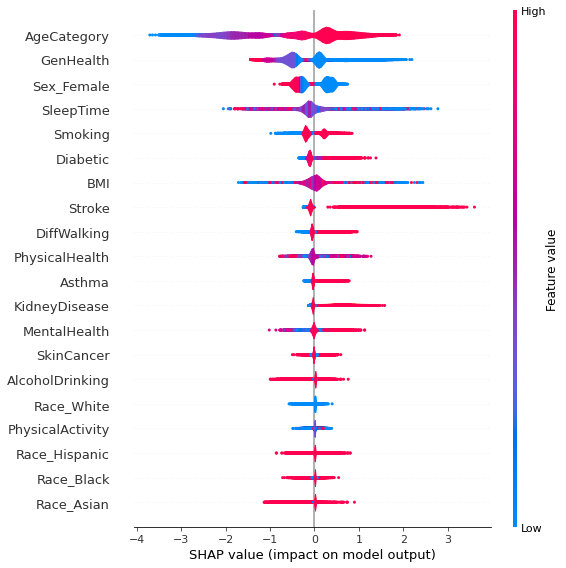

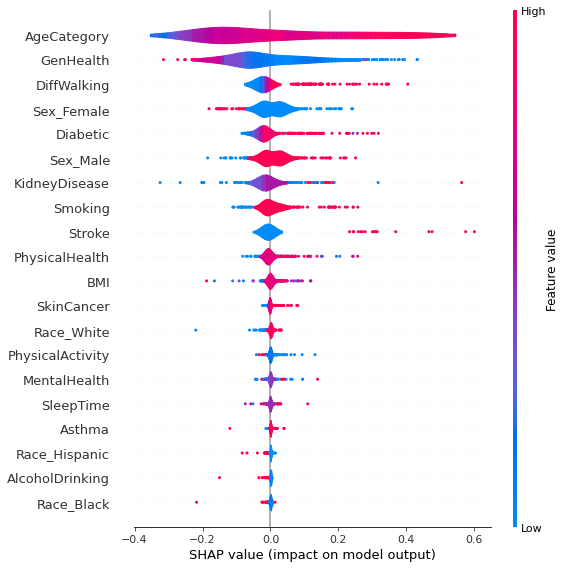

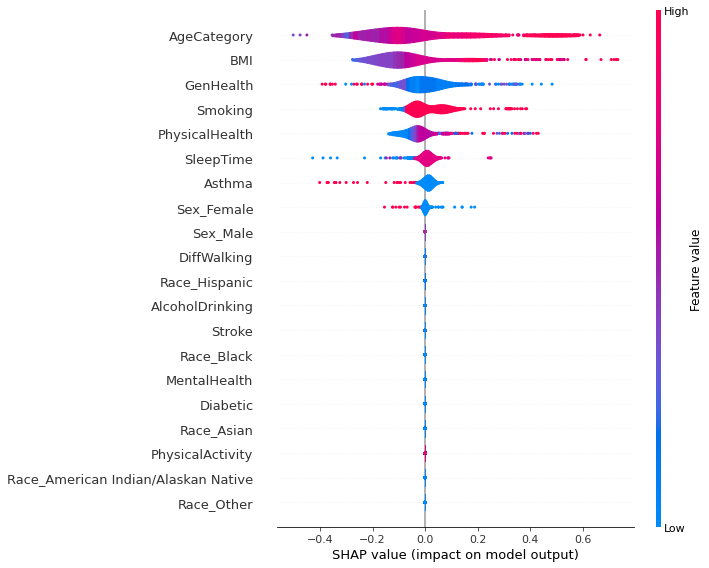

In [30]:
for shaps in shap_vals:
  shap.summary_plot(shaps, plot_type="violin")

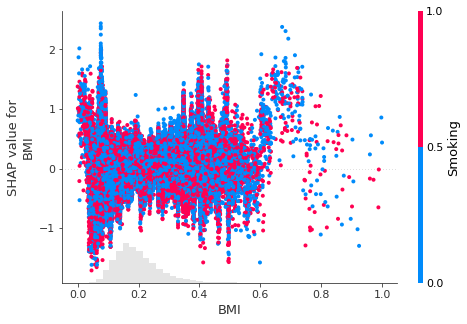

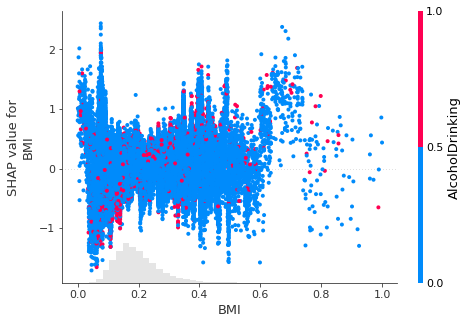

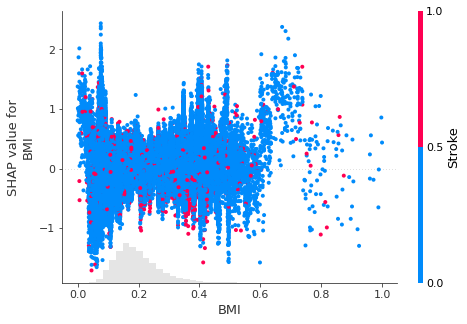

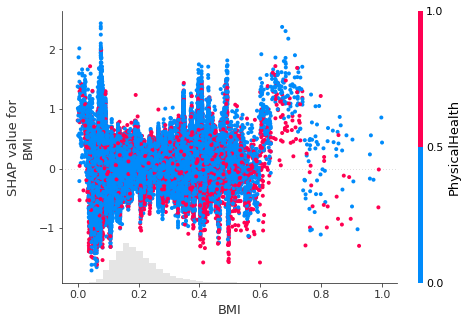

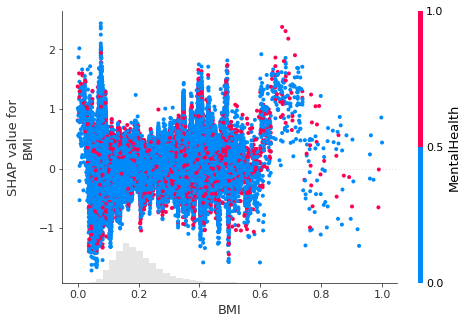

...

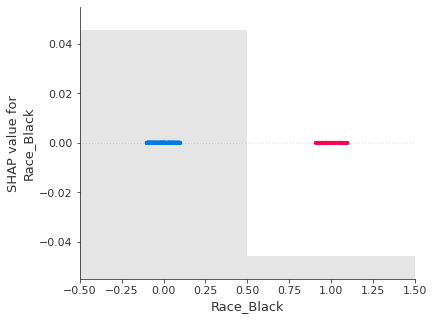

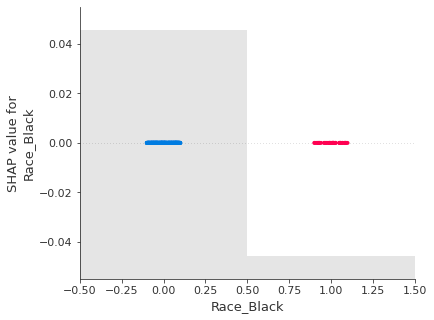

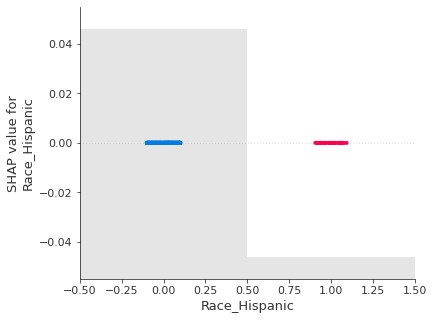

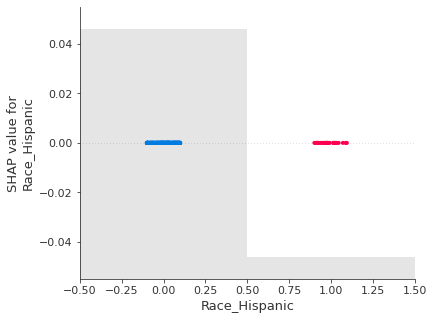

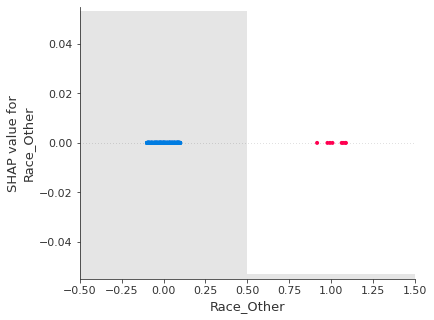

In [31]:
for shaps in shap_vals:
  names = shaps.feature_names
  for k in range(0, len(names)):
      for j in range(k, len(names)):
        if(names[k] != names[j]):
          shap.plots.scatter(shaps[:, names[k]], color=shaps[:, names[j]])